# Previsão do Preço da Estadia - Airbnb Rio de Janeiro

Neste notebook, será realizado a regressão do preço da estadia em listagens de hospedagens do Airbnb, da cidade do Rio de Janeiro.

Dados extraídos de:
http://insideairbnb.com/get-the-data.html

# Instalando as bibliotecas necessárias

In [1]:
pip install pandas-profiling[notebook]


Note: you may need to restart the kernel to use updated packages.


In [2]:
!pip install nltk
!pip install keras

In [3]:
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import numpy as np
from datetime import date
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from itertools import product
from sklearn import preprocessing
from sklearn.linear_model import Ridge
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error,mean_absolute_error
import statistics as st
import joblib
import pickle
import string

# Obtendo os dados

Através de uma análise prévia e descrição dos arquivos na fonte, o arquivo `listings.csv` parece uma versão sumarizada do arquivo `listings.csv.gz`



In [4]:
df_short = pd.read_csv("http://data.insideairbnb.com/brazil/rj/rio-de-janeiro/2021-01-26/visualisations/listings.csv")
df_total = pd.read_csv("http://data.insideairbnb.com/brazil/rj/rio-de-janeiro/2021-01-26/data/listings.csv.gz")

Comparando o início de cada arquivo:

In [5]:
df_short.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,17878,"Very Nice 2Br in Copacabana w. balcony, fast WiFi",68997,Matthias,NaN,Copacabana,-22.96592,-43.17896,Entire home/apt,201,5,258,2020-12-26,2.01,1,286
1,25026,Beautiful Modern Decorated Studio in Copa,3746246,Ghizlane,NaN,Copacabana,-22.97712,-43.19045,Entire home/apt,160,7,238,2020-02-15,1.84,11,357
2,35636,Cosy flat close to Ipanema beach,153232,Patricia,NaN,Ipanema,-22.98816,-43.19359,Entire home/apt,273,2,181,2020-03-15,2.05,1,300
3,35764,COPACABANA SEA BREEZE - RIO - 20 X Superhost,153691,Patricia Miranda & Paulo,NaN,Copacabana,-22.98127,-43.19046,Entire home/apt,135,3,350,2021-01-24,2.79,1,84
4,41198,"Modern 2bed,Top end of Copacabana",178975,Nicky,NaN,Copacabana,-22.97962,-43.19230,Entire home/apt,492,3,18,2016-02-09,0.19,2,365


In [6]:
df_total.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,17878,https://www.airbnb.com/rooms/17878,20210126045954,2021-01-27,"Very Nice 2Br in Copacabana w. balcony, fast WiFi",Discounts for long term stays. <br />- Large b...,This is the one of the bests spots in Rio. Bec...,https://a0.muscache.com/pictures/65320518/3069...,68997,https://www.airbnb.com/users/show/68997,...,10.0,10.0,9.0,NaN,t,1,1,0,0,2.01
1,25026,https://www.airbnb.com/rooms/25026,20210126045954,2021-01-27,Beautiful Modern Decorated Studio in Copa,"Our apartment is a little gem, everyone loves ...",Copacabana is a lively neighborhood and the ap...,https://a0.muscache.com/pictures/3003965/68ebb...,3746246,https://www.airbnb.com/users/show/3746246,...,10.0,10.0,9.0,NaN,f,11,11,0,0,1.84
2,35636,https://www.airbnb.com/rooms/35636,20210126045954,2021-01-26,Cosy flat close to Ipanema beach,This cosy apartment is just a few steps away ...,The apartment street is very quiet and safe ....,https://a0.muscache.com/pictures/20009355/38b6...,153232,https://www.airbnb.com/users/show/153232,...,10.0,10.0,9.0,NaN,f,1,1,0,0,2.05
3,35764,https://www.airbnb.com/rooms/35764,20210126045954,2021-01-26,COPACABANA SEA BREEZE - RIO - 20 X Superhost,Our newly renovated studio is located in the b...,Our guests will experience living with a local...,https://a0.muscache.com/pictures/23782972/1d3e...,153691,https://www.airbnb.com/users/show/153691,...,10.0,10.0,10.0,NaN,f,1,1,0,0,2.79
4,41198,https://www.airbnb.com/rooms/41198,20210126045954,2021-01-26,"Modern 2bed,Top end of Copacabana","<b>The space</b><br />Stay in this, Modern,cle...",NaN,https://a0.muscache.com/pictures/3576716/2d6a9...,178975,https://www.airbnb.com/users/show/178975,...,9.0,9.0,9.0,NaN,f,2,2,0,0,0.19


E comparando o número de observações e número de variáveis:

In [7]:
print("Número de linhas df_short e total: {},{} \nNúmero de variáveis df_short e total:{},{}".format(len(df_short),len(df_total),len(df_short.columns),len(df_total.columns)))

Número de linhas df_short e total: 26106,26106 
Número de variáveis df_short e total:16,74


Concluímos que `df_short` e `df_total` referem-se às mesmas observações, com a diferença que `df_total` possui mais variáveis.


Faz sentido iniciarmos uma análise exploratória da versão mais compacta, para depois seguirmos com a versão completa.

Como os dois arquivos referem-se aos mesmos anúncios, podemos fazer as análises e transformações de atributos dos dataframes em separado para no final agrupar as colunas relevantes em um único dataframe. Com o dataframe único resultante, podemos seguir com o saneamento dos dados.

# Exploração Inicial - Listings Sumarizado


## Considerações Gerais

Como já fizemos uma análise visual, podemos seguir com uma análise mais detalhada utilizando o `pandas-profiling`

In [102]:
profile = ProfileReport(df_short, title="Pandas Profiling Report")
profile.to_widgets()

### Número de observações e variáveis

Do campo `overview` do relatório, vemos que o conjunto tem 26106 observações e 16 variáveis - 10 numéricas, 5 categóricas e 1 não-suportada.


### Valores Ausentes

- `neighbourhood group` tem 100% dos valores ausentes, e pode ser descartada
- `last_review` e `reviews_per_month` tem quase 37% de valores ausentes, e por isso também serão descartadas

### Variáveis Não-aplicáveis

- `host_name` é um campo textual cuja informação é mais bem representada pelo campo `host_id`. Por este motivo, pode ser descartada
- `name` é um campo textual cuja informação também está presente nos demais campos. Por este motivo, pode ser descartada

### Possíveis Outliers


Na aba `warnings` em `overview`, algumas observações podem ser realizadas:
- O campo `price` é altamente enviesado. Avaliando esta variável na seção `variables`, no campo `statistics`, vemos que `price` apresenta 95% dos valores abaixo de 2000, sendo que o valor máximo é de 626623. O histograma na aba `histogram` também reforça a existência desta distorção. Uma análise mais aprofundada deve ser feita.
- O mesmo comentário acima vale para o campo `minimum_nights`. 95-th percentil = 10 e valor máximo = 1111. Provável presença de outlier.

### Correlações

Na aba `correlations`, podemos avaliar algumas correlações entre as variáveis. Como podem existir correlações não-lineares entre as variáveis, o heatmap referente à correlação de __Spearman__ é mais indicada.

Vemos que:
- `Price` parece ter uma correlação com `Number of reviews` e `Reviews per month`
- `Price` parece ter alguma correlação com `latitude` e `longitude`
- `Number of reviews` e `Reviews per month` são altamente correlacionadas
- `Latitude` e `Longitude` são altamente correlacionadas

Estas informações são importantes, pois um bom subconjunto de variáveis para a predição de uma variável alvo deve ser altamente correlacionada com a classe alvo, porém não correlacionado entre si.[1]



### Variáveis Categóricas

Outro ponto importante é que o campo `Neighbourhood`, por não ser numérico, não está presente no gráfico de correlações, mas também pode ser relevante para a análise. Por este motivo, pode valer a pena realizar uma codificação categórica nesta variável ou então agrupar as variáveis (`latitude`,`longitude`). O mesmo vale para o campo `Room Type`. 

## Removendo Variáveis não-aplicáveis

De acordo com as considerações acima, removemos previamente algumas variáveis não relevantes:

In [9]:
to_drop = ['last_review','reviews_per_month','host_name','name','neighbourhood_group']
df_short = df_short.drop(to_drop,axis=1)

## Análise de Outliers - Price

Podemos avaliar melhor o campo `price` através de um box plot:

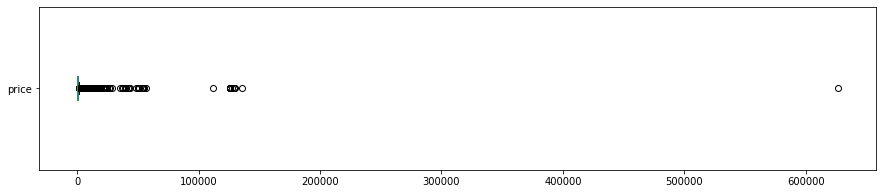

In [10]:
df_short.price.plot(kind='box', vert=False, figsize=(15,3))
plt.show()

Visualmente, o valor de 100 000 parece ser um bom ponto de corte para remover outliers.

Uma técnica bastante comum é o cálculo do __z-score__, e remover pontos com valor do z_score acima de 3 (O que significa que o ponto está mais de 3 desvios-padrão acima/abaixo da média).

Podemos calcular o __z-score__ de cada ponto, e avaliar o link de alguns pontos com valor acima de 3 para verificar se se trata de um erro de digitação, ou se é um anúncio legítimo:

In [11]:
price = df_short.price
mean = np.mean(price) 
std = np.std(price)

print("Média>",mean)
print("Desvio>",std)
threshold = 3
outliers = [] 
for index,row in df_short.iterrows():
    data = int(row['price'])
    z = (data-mean)/std 
    if z > threshold: 
        outliers.append((df_total.iloc[[index]]['listing_url'].values.tolist()[0],data))
print("Outliers:")
# limitando a visualização para não poluir o notebook
print(outliers[:5])


Média> 730.8430245920478
Desvio> 5149.300567058912
Outliers:
[('https://www.airbnb.com/rooms/1072499', 22149), ('https://www.airbnb.com/rooms/1074443', 21723), ('https://www.airbnb.com/rooms/1074595', 22149), ('https://www.airbnb.com/rooms/1076977', 21938), ('https://www.airbnb.com/rooms/1078107', 21938)]


Avaliando alguns pontos na lista de outliers, claramente os apartamentos não correspondem com o valor inserido, tratando-se de anúncios errôneos.

Portanto, baseado nos resultados de __z score__ obtidos e análise visual dos dados, valores com `price` acima de 20 mil serão removidos da análise/treinamento.

# Análise e Remoção de Outliers - Minimum Nights

Repetindo a mesma análise para o campo `minimum_nights`:

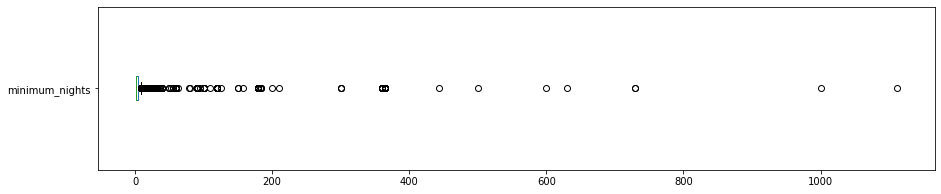

In [12]:
df_short.minimum_nights.plot(kind='box', vert=False, figsize=(15,3))
plt.show()

In [13]:
nights = df_short.minimum_nights
mean = np.mean(nights) 
std = np.std(nights)

print("Média>",mean)
print("Desvio>",std)
threshold = 3
outliers = [] 
for index,row in df_short.iterrows():
    data = int(row['minimum_nights'])
    z = (data-mean)/std 
    if z > threshold: 
        outliers.append((df_total.iloc[[index]]['listing_url'].values.tolist()[0],data))
print("Outliers:")
# limitando a visualização para não poluir o notebook
print(outliers[:5])

Média> 4.773040680303379
Desvio> 20.163491597373056
Outliers:
[('https://www.airbnb.com/rooms/273363', 90), ('https://www.airbnb.com/rooms/284910', 365), ('https://www.airbnb.com/rooms/404811', 90), ('https://www.airbnb.com/rooms/503279', 360), ('https://www.airbnb.com/rooms/636889', 365)]


Neste caso, uma análise dos anúncios indicam que, apesar de incomuns, um período mínimo de até 1 ano pode ser legítimo, com os proprietários explicando que procuram por clientes para longa temporada. Acima deste valor, não parece haver maiores explicações acerca do valor extraordinariamente alto, em alguns casos sendo acompanhado também por distorções de preço.

Por este motivo, valores acima de 365 serão removidos da análise/treinamento.

# Categorical Encoding

Para fazer uso da variável `neighbourhood`, é preciso convertê-la para um formato adequado. Uma maneira possível seria utilizar __one_hot encoding__, mas como temos 151 valores distintos, esta opção criaria um número grande de variáveis.

Outra maneira simples de se realizar isto é usando __label encoding__. Existem outras maneira mais elaboradas, mas por enquanto vamos utilizar __label encoding__.

In [14]:
df_short["neighbourhood"] = df_short["neighbourhood"].astype('category')
df_short["neighbourhood_cat"] = df_short["neighbourhood"].cat.codes
df_short = df_short.drop("neighbourhood",axis=1)
df_short["neighbourhood_cat"].head()



0    32
1    32
2    62
3    32
4    32
Name: neighbourhood_cat, dtype: int16

Já para o campo `room_type`, como temos apenas 4 valores distintos, podemos usar __one-hot encoding__:

In [15]:
df_short = pd.get_dummies(df_short, columns=["room_type"])
df_short.head()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,calculated_host_listings_count,availability_365,neighbourhood_cat,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,17878,68997,-22.96592,-43.17896,201,5,258,1,286,32,1,0,0,0
1,25026,3746246,-22.97712,-43.19045,160,7,238,11,357,32,1,0,0,0
2,35636,153232,-22.98816,-43.19359,273,2,181,1,300,62,1,0,0,0
3,35764,153691,-22.98127,-43.19046,135,3,350,1,84,32,1,0,0,0
4,41198,178975,-22.97962,-43.19230,492,3,18,2,365,32,1,0,0,0


# Exploração Inicial - Listings Completo

## Saneamento Inicial

Por conta do volume inicial de variáveis, repetir a análise inicial via `pandas-profiling` poderia causar alguma confusão.

Vamos tentar avaliar de outras maneiras e aparar o excesso.

Primeiramente, vamos considerar que o uso de variáveis com uma __taxa de ausência__ muito alta é proibitivo, pois reduziria significativamente a quantidade disponível de amostras.

Assim, já eliminamos todas as variáveis que estão ausentes em mais de __5%__ das observações:

In [16]:
threshold = 0.05

(df_total.isnull().sum() / df_total.shape[0]).sort_values(ascending= False)
to_keep = []
for x in df_total.columns:
    null_pct = df_total[x].isnull().sum()/len(df_total) 
    if null_pct < threshold:
        to_keep.append(x)

df_total = df_total[to_keep]

Vamos eliminar também as colunas que já avaliamos no dataframe sumarizado `df_short` (com exceção da coluna `id`):

In [17]:
short_columns = df_short.columns
print(short_columns)

to_drop = [x for x in df_total.columns if x in short_columns and x != 'id']
print(len(to_keep))

df_total = df_total.drop(to_drop,axis=1)

Index(['id', 'host_id', 'latitude', 'longitude', 'price', 'minimum_nights',
       'number_of_reviews', 'calculated_host_listings_count',
       'availability_365', 'neighbourhood_cat', 'room_type_Entire home/apt',
       'room_type_Hotel room', 'room_type_Private room',
       'room_type_Shared room'],
      dtype='object')
51


Vamos avaliar o nome e tipo das colunas restantes:

In [18]:
print(df_total.dtypes)

id                                                int64
listing_url                                      object
scrape_id                                         int64
last_scraped                                     object
name                                             object
picture_url                                      object
host_url                                         object
host_name                                        object
host_since                                       object
host_location                                    object
host_is_superhost                                object
host_thumbnail_url                               object
host_picture_url                                 object
host_listings_count                             float64
host_total_listings_count                       float64
host_verifications                               object
host_has_profile_pic                             object
host_identity_verified                          

Com base apenas no nome das variáveis e análise visual realizada anteriormente, podemos remover colunas que claramente não são relevantes para a regresso da variável alvo `price`: 

In [19]:
ignore = ['last_scraped','calendar_last_scraped','host_location','host_since','host_verifications','picture_url','host_url','host_thumbnail_url','host_picture_url','neighbourhood_cleansed']
df_total = df_total.drop(ignore,axis=1)

A variável `price` foi eliminada anteriormente, e estava formatada de uma maneira menos adequada que a presente em `df_short`.

Vamos reinseri-la, para futuramente podermos avaliar as correlações.

In [20]:
df_total['price'] = df_short['price'].values

Agora sim, podemos avaliar os dados remanescentes com o `pandas-profiling`

In [103]:
profile_total = ProfileReport(df_total, title="Pandas Profiling Report")
profile_total.to_widgets()

Através do relatório acima, podemos verificar alguns pontos:

- `scrape_id` é constante e pode ser ignorado
- `host_total_listings_coun` é igual à `host_listings_count`, que já foi avaliado em uma variável semelhante em __df_short__
- as variáveis relativas à `minimum_nights` são altamente correlacionadas, e já foi avaliada em __df_short__
- as variáveis relativas à `maximum_night` são altamente correlacionadas, bastando manter apenas uma (`maximum_nights`)
- as variáveis relativas à `availability` são altamente correlacionadas, bastando manter apenas uma (`availability_30`)
- `host_verifications` apresenta alta cardinalidade, e é um campo textual, que não será avaliado nesta análise
- `host_has_profile_pic` tem o mesmo valor em 99.7% dos casos, sendo portanto eliminado da análise
- `amenities` é um campo textual de alta cardinalidade. No entanto, a informação contida no campo parece ser importante. Por este motivo, será avaliada em maiores detalhes

Sendo assim, eliminamos as seguintes colunas do dataframe:
 

In [22]:
to_drop = ['name','host_name','room_type','scrape_id','host_listings_count','host_total_listings_count','minimum_minimum_nights','maximum_minimum_nights',
           'minimum_maximum_nights','maximum_maximum_nights','minimum_nights_avg_ntm','maximum_nights_avg_ntm','availability_60',
           'availability_90','host_has_profile_pic']

df_total = df_total.drop(to_drop,axis=1)

## Variáveis Categóricas

De maneira análoga à análise feita para __df_short__, as seguintes variáveis categóricas serão codificadas:
- `host_is_superhost`
- `host_identity_verified`
- `has_availability`
- `instant_bookable`
- `bathrooms_text`
- `property_type`

In [23]:
categorical_features = ['host_is_superhost','host_identity_verified','has_availability','instant_bookable','bathrooms_text','property_type']
for feature in categorical_features:
    df_total[feature] = df_total[feature].astype('category')
    df_total["{}_cat".format(feature)] = df_total[feature].cat.codes
df_total=df_total.drop(categorical_features,axis=1)
df_total.head()

,id,listing_url,accommodates,beds,amenities,maximum_nights,availability_30,number_of_reviews_ltm,number_of_reviews_l30d,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,price,host_is_superhost_cat,host_identity_verified_cat,has_availability_cat,instant_bookable_cat,bathrooms_text_cat,property_type_cat
0,17878,https://www.airbnb.com/rooms/17878,5,2.0,"[""Air conditioning"", ""Hot tub"", ""Cooking basic...",180,9,13,0,1,0,0,201,1,1,1,1,2,10
1,25026,https://www.airbnb.com/rooms/25026,2,2.0,"[""Essentials"", ""Bed linens"", ""Elevator"", ""Cabl...",60,22,2,0,11,0,0,160,0,0,1,0,2,5
2,35636,https://www.airbnb.com/rooms/35636,2,1.0,"[""Air conditioning"", ""Hangers"", ""Cooking basic...",89,0,6,0,1,0,0,273,1,1,1,0,5,5
3,35764,https://www.airbnb.com/rooms/35764,2,1.0,"[""Air conditioning"", ""Hangers"", ""Cooking basic...",15,7,25,4,1,0,0,135,1,1,1,0,2,19
4,41198,https://www.airbnb.com/rooms/41198,5,0.0,"[""Elevator"", ""Cable TV"", ""Air conditioning"", ""...",365,30,0,0,2,0,0,492,0,1,1,0,2,5


## Remoção de Outliers

De maneira análoga à análise anterior, podemos avaliar o __box plot__ do campo `maximum_nights`:

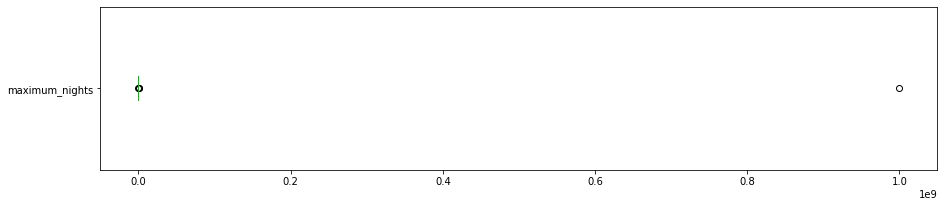

In [24]:
df_total.maximum_nights.plot(kind='box', vert=False, figsize=(15,3))
plt.show()

In [25]:
max_nights = df_total.maximum_nights
mean = np.mean(price) 
std = np.std(price)

print("Média>",mean)
print("Desvio>",std)

threshold = 3
outliers = [] 
for index,row in df_total.iterrows():
    try:
        data = int(row['maximum_nights'])
        z = (data-mean)/std 
        if z > threshold: 
            outliers.append((df_total.iloc[[index]]['listing_url'].values.tolist()[0],data))

    except ValueError:
#         print("is nan!")
        #NaN
        pass
print("Outliers:")
# limitando a visualização para não poluir o notebook
print(outliers[:5])

Média> 730.8430245920478
Desvio> 5149.300567058912
Outliers:
[('https://www.airbnb.com/rooms/628044', 999999999), ('https://www.airbnb.com/rooms/5915164', 30000), ('https://www.airbnb.com/rooms/19840831', 47036)]


Neste caso, vemos que o limiar de __z score__ de 3 se adequa bem, detectando como outliers apenas 3 pontos, mas que apresentam um valor muito superior ao restante. Removendo estes pontos e replotando o boxplot, vemos que os valores fazem mais sentido. Recalculando os __z scores__, nenhum outlier é indicado.

Por este motivo, valores de `maximum_nights` acima de 30 000 serão removidos.

In [26]:
df_prune = df_total[df_total['maximum_nights']<30000]

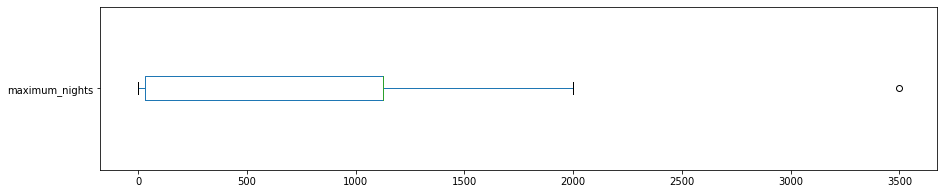

In [27]:
df_prune.maximum_nights.plot(kind='box', vert=False, figsize=(15,3))
plt.show()

O campo `beds` também merece ser avaliado. Apesar de não ter sido indicado um viés em `beds`, e nenhum valor apresentar __z score__ acima de 3, é suspeito uma acomodação apresentar 50 camas.

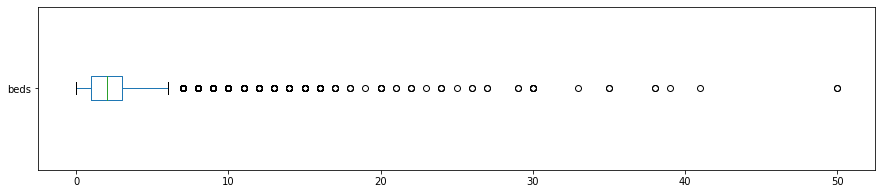

In [28]:
df_total.beds.plot(kind='box', vert=False, figsize=(15,3))
plt.show()

Vamos avaliar alguns anúncios com `beds` acima de 20.

In [29]:
beds = df_total.price
mean = np.mean(price) 
std = np.std(price)

print("Média>",mean)
print("Desvio>",std)

threshold = 3
outliers = [] 
for index,row in df_total.iterrows():
    try:
        data = int(row['beds'])
        z = (data-mean)/std 
        if z > threshold: 
            outliers.append((df_total.iloc[[index]]['listing_url'].values.tolist()[0],data))
        if data>20:
            outliers.append((df_total.iloc[[index]]['listing_url'].values.tolist()[0],data))

    except ValueError:
#         print("is nan!")
        #NaN
        pass
print("Outliers:")
# limitando a visualização para não poluir o notebook
print(outliers[:5])


Média> 730.8430245920478
Desvio> 5149.300567058912
Outliers:
[('https://www.airbnb.com/rooms/575720', 50), ('https://www.airbnb.com/rooms/3760061', 24), ('https://www.airbnb.com/rooms/10861088', 35), ('https://www.airbnb.com/rooms/12169013', 30), ('https://www.airbnb.com/rooms/13427108', 41)]


Analisando os anúncios, constata-se nestes casos que o anfitrião preencheu o campo `beds` como sendo o número total de camas do hotel/pousada, e não do cômodo/apartamento que está sendo anunciado. São preenchimentos incorretos, e por este motivo serão removidos da análise.

Como usamos pela última vez o campo `listing_url` para inspeção e `price` já está presente em __df_short__, vamos removê-los também:

In [30]:
df_total = df_total.drop(['listing_url','price'],axis=1)

# Agrupamento - Listings sumarizado e completo

Finalmente, podemos agrupar os dois dataframes avaliados e saneados.

In [31]:
df = pd.merge(df_short, df_total, on="id")

Como o atributo `id` não é importante para a regressão, vamos eliminá-lo:

In [32]:
df = df.drop("id",axis=1)

Agora que temos um dataframe único, podemos eliminar as linhas que foram definidas anteriormente como __outliers__:

In [33]:
print("Antes da remoção:",len(df))
df = df[df['price']<=20000]
df = df[df['price']!=0]
df = df[df['minimum_nights']<=365]
df = df[df['maximum_nights']<30000]
df = df[df['beds']<=20]
print("Após remoção:",len(df))

Antes da remoção: 26106
Após remoção: 25779


# O Campo Amenities

Da maneira como está, o campo `Amenities` não pode ser usado em modelos convencionais de regressão. No entanto, as informações contidas parecem ser importante, contendo informações sobre as hospedagens, como wifi, ar-condicionado, estacionamento, etc.

Por esse motivo, uma avaliação e transformação será realizada para que possamos tirar proveito desta informação.

Ao fim, mapearemos as principais características em atributos individuais binários, marcando __1__ se a hospedagem conta com aquela característica ou __0__ se não conta.

Vamos primeiro importar algumas bibliotecas e definir funções que utilizaremos mais à frente.

In [34]:
# from nltk.tokenize import word_tokenize

In [35]:
# def clean_string(sample):
#     sample = sample.lower()
#     sample = sample.strip('[]')
#     exclude = set(string.punctuation)
#     sample = ''.join(ch for ch in sample if ch not in exclude)
#     return sample

In [36]:
def get_amenities_list(sample):
    sample = sample.strip('[]')
    sample = sample.replace('"\'','')
    sample = sample.split(',')
    am_set = [x.strip() for x in sample ]
    am_set
    return am_set

In [37]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\felip\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [38]:
# from nltk.probability import FreqDist
# from nltk.collocations import BigramCollocationFinder 
# from nltk.metrics import BigramAssocMeasures 

Primeiro, vamos agrupar todos os textos de `amenities`, limpar alguns caracteres e pontuações e separar o texto em palavras (__tokens__).

In [39]:
# all_tokens = []
# for index,row in df.iterrows():
#     am_string = row['amenities']
#     am_string = clean_string(am_string)
#     tokens = word_tokenize(am_string)
#     all_tokens.extend(tokens)



Vamos avaliar as 50 palavras mais frequentes no conjunto resultante:

In [40]:
# FreqDist(all_tokens).most_common(100)[50:]

Um problema é que existem termos que só fazem sentidos junto, como __Air Conditioning__, __Hair dryer__, assim por diante.
Convém avaliarmos também os 50 __bigramas__ mais frequentes.

__Bigramas__ são 2 palavras individuais que aparecem em conjunto com frequência.

In [41]:
# biagram_collocation = BigramCollocationFinder.from_words(all_tokens) 
# biagram_collocation.nbest(BigramAssocMeasures.likelihood_ratio, 100)[50:]

Ainda podemos ver que existem termos importantes de 3 palavras, como __first aid kit__ e __dishes and silverware__. Vamos avaliar também os __trigramas__ mais comuns.

In [42]:
# from nltk.collocations import TrigramCollocationFinder 
# from nltk.metrics import TrigramAssocMeasures 

# trigram_collocation = TrigramCollocationFinder.from_words(all_tokens) 
# trigram_collocation.nbest(TrigramAssocMeasures.likelihood_ratio, 100)[50:]

A partir da lista dos __tokens__,__bigramas__ e __trigramas__ mais comuns, podemos inspecionar visualmente à procura de termos que façam sentido para montar um conjunto de __amenities__:

In [43]:
# am_columns = ['tv','kitchen','wifi','parking','elevator','refrigerator','microwave','air conditioning','dedicated workspace','hot water',
#  'hair dryer','cooking basics','bed linens','coffee maker','stove','oven','pool','fire extinguisher','extra pillows','cable tv',
# 'luggage dropoff','free parking','private entrance','shampoo','smoke alarm','street parking','paid parking','dishes and silverware',
# 'patio','balcony','first aid kit','netflix','gym','hot tub','lock','shades','beachfront','backyard','heating','breakfast',
# 'ethernet connection','bbq','grill','fan','laundromat','hangers','soap','window guards','long term']

A partir de `amenities`, vamos separar os termos por vírgula e agregá-los em um conjunto de todos os termos que aparecem, sem repetições.

Como não há um padrão para os termos, muitos serão únicos, e não se prestam para a nossa análise. Vamos utilizar os termos que aparecem em cerca de 1% dos dados, filtrando assim os termos que aparecem mais de 250 vezes.

In [44]:
whole_amenities_set = []
am_counter = {}
for index,row in df.iterrows():
    am_string = row['amenities']
    am_set = get_amenities_list(am_string)
    for am in am_set:
        am = am.strip('\"')
        times_am = am_counter.get(am,0)
        am_counter[am] = times_am + 1
    first_am = [x for  x in am_set if x not in whole_amenities_set]
    whole_amenities_set.extend(first_am)
# whole_amenities_set
am_counter

am_columns = [key for key in am_counter if am_counter[key]>250]
"Numero de amenities após filtragem: {}".format(len(am_columns))

'Numero de amenities após filtragem: 82'

Apenas ajustando o conjunto para apenas letras minúsculas:

In [45]:
am_columns  = [x.lower() for x in am_columns]

Criando as novas colunas, inicialmente todas com 0, para cada característica:

In [46]:
# am_map = {}
for ix,col in enumerate(am_columns):
    df[col] = 0
#     am_map[col] = ix
    

E então, para cada linha do dataframe, vamos preencher as colunas com __1__ caso a característica esteja presente:

In [47]:
for index,row in df.iterrows():
    am_string = row['amenities']
    am_set = get_amenities_list(am_string)
    for am in am_set:
        am = am.lower()
        am = am.strip('\"')
        if am in am_columns:
#             am_ix = am_map.get(am)
#             am_col = 'am_{}'.format(am_ix)
#             print("heereee")
            df.loc[index,am] = 1
#             df.iloc[index][am] = 1
df.head()


# for index,row in df.iterrows():
#     am_string = row['amenities']
#     am_string = clean_string(am_string)
#     for am in am_columns_2:
#         if am in am_string: 
# #             print("heereee")
#             df.loc[index,am] = 1
# #             df.iloc[index][am] = 1
# df.head()

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,calculated_host_listings_count,availability_365,neighbourhood_cat,room_type_Entire home/apt,...,dining table,clothing storage,pour-over coffee,drying rack for clothing,nespresso machine,children\u2019s books and toys,smart lock,lake access,window guards,portable fans
0,68997,-22.96592,-43.17896,201,5,258,1,286,32,1,...,0,0,0,0,0,0,0,0,0,0
1,3746246,-22.97712,-43.19045,160,7,238,11,357,32,1,...,0,0,0,0,0,0,0,0,0,0
2,153232,-22.98816,-43.19359,273,2,181,1,300,62,1,...,0,0,0,0,0,0,0,0,0,0
3,153691,-22.98127,-43.19046,135,3,350,1,84,32,1,...,0,0,0,0,0,0,0,0,0,0
4,178975,-22.97962,-43.19230,492,3,18,2,365,32,1,...,0,0,0,0,0,0,0,0,0,0


Agora, não precisamos mais do campo original

In [48]:
df = df.drop("amenities",axis=1)

# Divisão Treino-Teste

Agora podemos dividir nosso dataframe em conjuntos de treino e teste.

A ideia é fazermos todos os ajustes de hiperparâmetros no conjunto de treino, deixando o conjunto de teste apenas para a validação do modelo final.

Podemos testar vários tipos de modelos e compará-los com o conjunto de testes.

In [49]:
'''
O valor previsto pelo modelo de regressão linear pode acabar sendo negativo, o que não faz sentido para um valor de preço.
Por isso, vamos treinar o modelo para prever o log de preço. No final, podemos inverter o valor para encontrar o valor em reais.
'''
df['price'] = np.log10(df['price'])
df_target = df['price']
df_features = df.drop('price',axis=1)

'''
Por padrão, separa em 75%-25% (Treino/Teste) e embaralha os dados.
Fixamos o random_state para reproducibilidade.
'''
x_train, x_test, y_train, y_test = train_test_split(
    df_features, df_target, random_state=42)

In [50]:
y_train=pd.DataFrame(y_train).values
y_test=pd.DataFrame(y_test).values

x_train=pd.DataFrame(x_train).values
x_test=pd.DataFrame(x_test).values


# Seleção de Atributos

Para evitar incluir atributos irrelevantes como entrada para os modelos, existem muitos métodos de seleção de atributos.

Nesta análise, um estudo prévio foi feito utilizando um método de seleção baseado em __informação mútua__. No entanto, as experimentações não resultaram em uma melhora.

Por esse motivo, não foi utilizado seleção de atributos nenhuma neste estudo.

A explicação de não haver melhora é provavelmente pelo fato de que os métodos utilizados já fazem uma espécie de seleção de atributos de maneira integrada ao método. No primeiro método, a regularização __Ridge__ já faz esta função de filtrar o ruído, e a árvore de decisões também "apara" os atributos irrelevantes.

No terceiro caso, da MLP, poderia esperar-se uma melhora. Os neurônios de entrada irrelevantes terão seus pesos gradualmente diminuídos, também amenizando a presença de atributos irrelevantes, mas uma maior experimentação com a seleção de atributos talvez pudessem resultar em ganho.

Apenas para referência, segue abaixo o bloco comentado de uma seleção de atributos baseada em __informação mútua__.

In [51]:
# from sklearn.feature_selection import SelectKBest
# from sklearn.feature_selection import mutual_info_regression


# selector = SelectKBest(mutual_info_regression, k=50)
# x_train_new = selector.fit_transform(x_train, y_train)
# x_test_new = selector.transform(x_test)

# Método 1 - Regressão Polinomial com Expansão de Base

Em muitos casos, um método mais simples pode ser tão bom quanto os mais elaborados. Vamos começar com um modelo de regressão linear.

Para adaptar a regressão linear para efeitos não-lineares, podemos utilizar uma transformação com __função de base polinomial__. Para evitar __overfitting__, vamos também aplicar regularização por __ridge__[2].

## Ajuste de Hiperparâmetros e Validação Cruzada

Vamos ajustar os hiperparâmetros do modelo, variando o grau da expansão polinomial `degree` e o grau de regularização `alpha`.

A combinação de hiperparâmetros que resultar na melhor performance será utilizada para o treinamento do modelo final.

Para isso, vamos subdividir o nosso conjunto de testes para realizar uma __validação cruzada__ de 5 pastas.

Para cada combinação de hiperparâmetros, treinamos o modelo 5 vezes, uma para cada divisão treino/validação da validação cruzada.

O modelo em si utiliza como função de custo a função dos __mínimos quadrados__, e vamos utilizar a média do __Erro Quadrático Médio__ entre as 5 iterações, para então obtermos uma métrica para cada combinação de hiperparâmetros. 

A combinação que resultar no menor __MSE__ é a escolhida para treinamento do modelo final.

In [52]:
kf = KFold(n_splits=5,shuffle=True,random_state=42)

In [53]:
#%% Grid Search
alpha = [0,0.01,0.1,1,10,100,1000]
degree = [1,2]

# alpha = [0.01]
# degree = [1]
param_grid = dict(alpha=alpha,
              degree=degree)
metrics = {}
for combination in list(product(*param_grid.values())):
    print("Combination:{}".format(combination))
    metrics[str(combination)] = {}
    metrics[str(combination)]['mse_k'] = []
    for train_index, validate_index in kf.split(x_train):
        
        yk_train=pd.DataFrame(y_train[train_index]).values
        yk_val=pd.DataFrame(y_train[validate_index]).values
        
        xk_train=pd.DataFrame(x_train[train_index]).values
        xk_val=pd.DataFrame(x_train[validate_index]).values
#         print(xk_train.shape)
#         print(xk_val.shape)
        
        '''
        A normalização dos conjuntos de treino e validação é feita com base nos dados do conjunto de treinos.
        Não se deve normalizar com base no conjunto inteiro para evitar que informações vazem do conjunto de validação.
        '''
        scaler_yk_train = preprocessing.MinMaxScaler()
        yk_train = scaler_yk_train.fit_transform(yk_train)
        yk_val = scaler_yk_train.transform(yk_val)
        
        scaler_xk_train = preprocessing.MinMaxScaler()
        xk_train = scaler_xk_train.fit_transform(xk_train)
        xk_val = scaler_xk_train.transform(xk_val)
        '''
        Modelo de Regressão Linear
        '''
        model = make_pipeline(PolynomialFeatures(degree=combination[1]),
                               Ridge(alpha=combination[0]))
        model.fit(xk_train, yk_train)
        yk_predict = model.predict(xk_val)
        mse = mean_squared_error(yk_val, yk_predict)
        metrics[str(combination)]['mse_k'].append(mse)
    metrics[str(combination)]['mse'] = st.mean(metrics[str(combination)]['mse_k'])

Combination:(0, 1)
Combination:(0, 2)
Combination:(0.01, 1)
Combination:(0.01, 2)
Combination:(0.1, 1)
Combination:(0.1, 2)
Combination:(1, 1)
Combination:(1, 2)
Combination:(10, 1)
Combination:(10, 2)
Combination:(100, 1)
Combination:(100, 2)
Combination:(1000, 1)
Combination:(1000, 2)


In [54]:
mses = [metrics[key]['mse'] for key in metrics]
for key in metrics:
    if metrics[key]['mse'] == min(mses):
        print("Best combination: {}\nWith mean MSE of: {}".format(key,min(mses)))

Best combination: (100, 2)
With mean MSE of: 0.00930472274159476


## Treinamento - Modelo Final

Agora que temos os hiperparêmtros ideais, vamos treinar o modelo final, no conjunto completo de treino, e validá-lo com o conjunto de testes.

In [55]:
alpha = 100
degree = 2


'''
A normalização dos conjuntos de treino e validação é feita com base nos dados do conjunto de treinos.
Não se deve normalizar com base no conjunto inteiro para evitar que informações vazem do conjunto de validação.
'''
scaler_y_train = preprocessing.MinMaxScaler()
y_train = scaler_y_train.fit_transform(y_train)
y_test = scaler_y_train.transform(y_test)

scaler_x_train = preprocessing.MinMaxScaler()
x_train = scaler_x_train.fit_transform(x_train)
x_test = scaler_x_train.transform(x_test)

# from sklearn.feature_selection import SelectKBest
# from sklearn.feature_selection import mutual_info_regression

# selector = SelectKBest(mutual_info_regression, k=70)
# x_train_new = selector.fit_transform(x_train, y_train)
# x_test_new = selector.transform(x_test)

# selector = SelectKBest(mutual_info_regression, k=10)
# x_train_new = selector.fit_transform(x_train, y_train)
# x_test_new = selector.transform(x_test)

'''
Modelo de Regressão Linear
'''
model = make_pipeline(PolynomialFeatures(degree=degree),
                       Ridge(alpha=alpha))
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
mse = mean_squared_error(y_test, y_predict)

print("MSE for the final mode is: {}".format(mse))

MSE for the final mode is: 0.009274129926745388


Vamos visualizar a regressão em um gráfico. Para facilitar a visualização, vamo ordenar os pontos reais de preço em valor crescente, e plotar em conjunto com as referidas predições.

In [56]:
zipped_lists = zip(y_test, y_predict)
sorted_pairs = sorted(zipped_lists)

tuples = zip(*sorted_pairs)
y_test_s, y_predict_s = [ list(tuple) for tuple in  tuples]

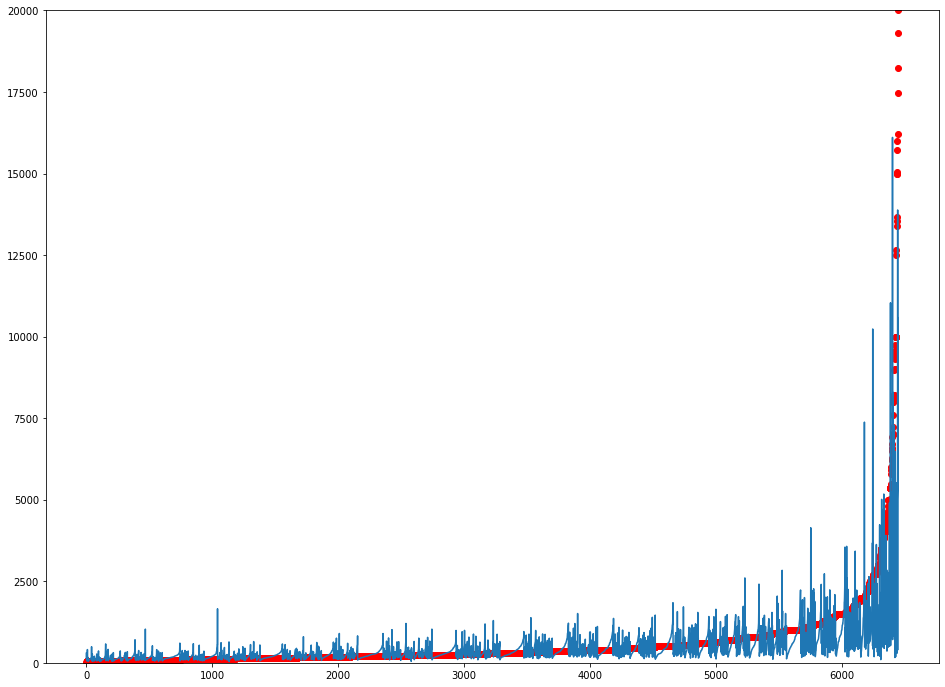

In [57]:
import math
fig=plt.figure(figsize=(16,12))
plt.ylim((0, 20000))
y_test_rev = scaler_y_train.inverse_transform(y_test_s)
y_predict_s_rev = scaler_y_train.inverse_transform(y_predict_s)
y_test_real = [10**x for x in y_test_rev]
y_predict_real = [10**x for x in y_predict_s_rev]
y_test_rev
plt.plot(y_test_real,'ro')
plt.plot(y_predict_real)
        
plt.show()

Vemos que a regressão acompanha a tendência da curva real, apesar de haver variações do valor real.

Muito provavelmente existem efeitos que não estão sendo capturados pelas variáveis utilizadas, ou então que o modelo não é capaz de capturar.

Para termos uma noção do erro em Reais, invertemos a normalização e então invertemos a função __log__ para então calcularmos o __Erro Médio Absoluto__:

In [58]:
mae = mean_absolute_error(y_test_real,y_predict_real)
'Erro médio absoluto de {} reais'.format(mae)

'Erro médio absoluto de 298.1081573662624 reais'

Para utilizar o modelo futuramente, podemos descomentar o bloco abaixo para salvar o modelo e os arquivos de normalização

In [59]:
# model_name = "linreg.joblib"
# model_metadata = {}
# model_metadata['features'] = list(df_features.columns)

# import json
# import pickle
# joblib.dump(model, model_name)
# with open('linreg_metadata.json', 'w') as fp:
#     json.dump(model_metadata, fp)
# with open('linreg_scaler_y.pickle','wb') as file:
#     pickle.dump(scaler_y_train,file)
# with open('linreg_scaler_x.pickle','wb') as file:
#     pickle.dump(scaler_x_train,file)


# Decision Trees

Vamos tentar um seguno método: __árvores de decisão__. Como nesta implementação mais básica a biblioteca permite a chamada sem definir hiperparâmteros, vamos pular a validação cruzada e treinar no conjunto completo de treino:

In [60]:
from sklearn.tree import DecisionTreeRegressor

In [61]:
regressor = DecisionTreeRegressor(random_state=0)
regressor.fit(x_train,y_train)

DecisionTreeRegressor(random_state=0)

In [62]:
y_pred_tree = regressor.predict(x_test).reshape(-1, 1)

Analogamente ao método anterior, vamos visualizar o resultado e calcular o erro médio absoluto.

In [63]:
zipped_lists = zip(y_test, y_pred_tree)
sorted_pairs = sorted(zipped_lists)

tuples = zip(*sorted_pairs)
y_test_t, y_predict_t = [ list(tuple) for tuple in  tuples]

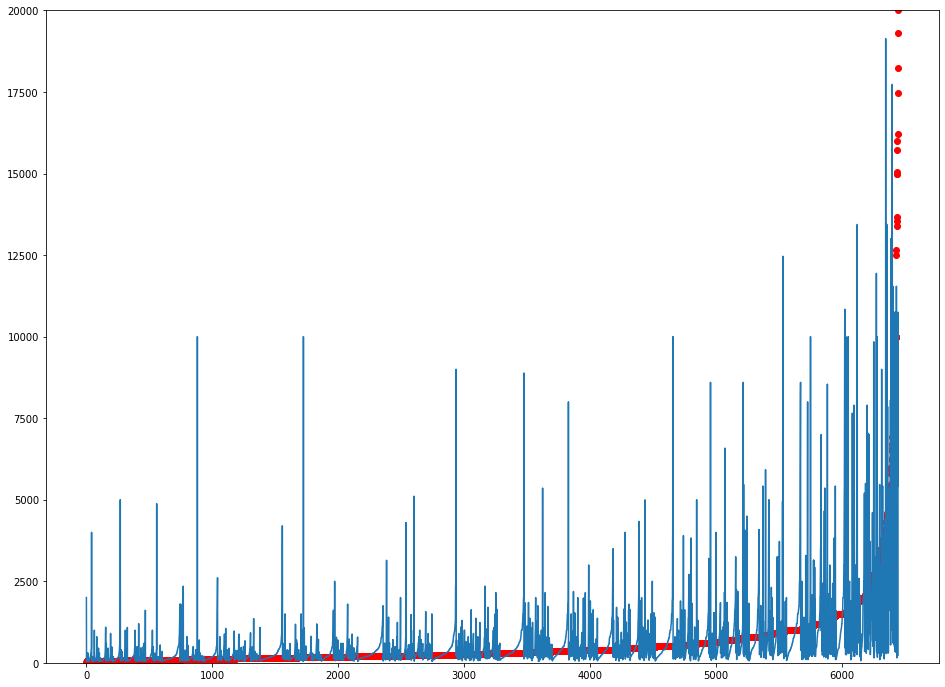

In [64]:
import math
fig=plt.figure(figsize=(16,12))
plt.ylim((0, 20000))
y_test_rev = scaler_y_train.inverse_transform(y_test_t)
y_predict_s_rev = scaler_y_train.inverse_transform(y_predict_t)
y_test_real = [10**x for x in y_test_rev]
y_predict_real = [10**x for x in y_predict_s_rev]
y_test_rev
plt.plot(y_test_real,'ro')
plt.plot(y_predict_real)
        
plt.show()

In [65]:
mae = mean_absolute_error(y_test_real,y_predict_real)
'Erro médio absoluto de {} reais'.format(mae)

'Erro médio absoluto de 425.022498060512 reais'

Vemos que a árvore de decisão teve uma performance pior do que a regressão linear, com maiores flutuações e maiores picos de distorções.

# Método 2 - Regressão com MLP

Para finalizar, vamos treinar uma __Multi Layer Perceptron__, utilizando a biblioteca __Keras__

In [66]:
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import SGD


Como no método 1, vamos fazer o ajuste dos hiperparâmetros: número de neurônios `neurons`, função de ativação da camada intermediária `activation_funcion` e taxa de aprendizagem `learning_rate`.

Vamos utilizar apenas uma camada intermediária.

Como nos métodos anteriores já exploramos o __MSE__ como função de custo, vamos tentar utilizar o __mean squared logarithmic error__. O __MSLE__ não penaliza tanto os grandes erros quanto o __MSE__. O método de otimização da rede neural é o __Stochastic Gradient Descent__.

In [101]:
neurons = [50,100,150]
activation_function = ['relu']
learning_rate = [0.1,0.2]

metrics = {}
param_grid = dict(neurons=neurons,
              activation_function=activation_function,
              learning_rate=learning_rate)

for combination in list(product(*param_grid.values())):
    print("Combination:{}".format(combination))
    metrics[str(combination)] = {}
    metrics[str(combination)]['mse_k'] = []
    for train_index, validate_index in kf.split(x_train):
        
        yk_train=pd.DataFrame(y_train[train_index]).values
        yk_val=pd.DataFrame(y_train[validate_index]).values
        
        xk_train=pd.DataFrame(x_train[train_index]).values
        xk_val=pd.DataFrame(x_train[validate_index]).values
#         xk_train=pd.DataFrame(x_train_new[train_index]).values
#         xk_val=pd.DataFrame(x_train_new[validate_index]).values

#         print(xk_train.shape)
#         print(xk_val.shape)
        
        '''
        A normalização dos conjuntos de treino e validação é feita com base nos dados do conjunto de treinos.
        Não se deve normalizar com base no conjunto inteiro para evitar que informações vazem do conjunto de validação.
        '''
        scaler_yk_train = preprocessing.MinMaxScaler()
        yk_train = scaler_yk_train.fit_transform(yk_train)
        yk_val = scaler_yk_train.transform(yk_val)
        
        scaler_xk_train = preprocessing.MinMaxScaler()
        xk_train = scaler_xk_train.fit_transform(xk_train)
        xk_val = scaler_xk_train.transform(xk_val)

        model = Sequential()
        model.add(Dense(x_train.shape[1], input_dim=x_train.shape[1], kernel_initializer='uniform', activation='tanh'))
        model.add(Dense(int(combination[0]), kernel_initializer='uniform', activation=str(combination[1])))
        model.add(Dense(1))    

        # Compile model
        #model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_squared_error'])
        opt=SGD(lr=float(combination[2]), momentum=0.9)

        # Compile model
        #model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_squared_error'])
        # opt=SGD(lr=0.2, momentum=0.9)
        model.compile(loss='mean_squared_logarithmic_error', optimizer=opt, metrics=['mean_squared_error'])

        # csv_logger = CSVLogger('rf.csv', append=True, separator=';')
        model.fit(xk_train, yk_train, epochs=100, batch_size=200,validation_data=(xk_val,yk_val), verbose=1)
        mse=model.evaluate(xk_val,yk_val)
#         print("type",type(mse))
#         print("mse>>",mse)
        metrics[str(combination)]['mse_k'].append(mse[0])
    metrics[str(combination)]['mse'] = st.mean(metrics[str(combination)]['mse_k'])


Combination:(50, 'relu', 0.1)
Epoch 1/100
78/78 [==============================] - 1s 3ms/step - loss: 0.0237 - mean_squared_error: 0.0438 - val_loss: 0.0069 - val_mean_squared_error: 0.0135
Epoch 2/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0067 - mean_squared_error: 0.0129 - val_loss: 0.0061 - val_mean_squared_error: 0.0117
Epoch 3/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0061 - mean_squared_error: 0.0119 - val_loss: 0.0056 - val_mean_squared_error: 0.0108
Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0110 - val_loss: 0.0059 - val_mean_squared_error: 0.0111
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0107 - val_loss: 0.0057 - val_mean_squared_error: 0.0107
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoc

78/78 [==============================] - 1s 3ms/step - loss: 0.0276 - mean_squared_error: 0.0490 - val_loss: 0.0081 - val_mean_squared_error: 0.0155
Epoch 2/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0072 - mean_squared_error: 0.0138 - val_loss: 0.0069 - val_mean_squared_error: 0.0135
Epoch 3/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0063 - mean_squared_error: 0.0121 - val_loss: 0.0064 - val_mean_squared_error: 0.0125
Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0059 - mean_squared_error: 0.0113 - val_loss: 0.0062 - val_mean_squared_error: 0.0116
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0108 - val_loss: 0.0061 - val_mean_squared_error: 0.0119
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0108 - val_loss: 0.0059 - val_mean_squared_error: 0.0114
Epoch 7/100
78/78 [===========================

Epoch 52/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0047 - mean_squared_error: 0.0090 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 53/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0047 - mean_squared_error: 0.0091 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoch 54/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0092 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 55/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0047 - mean_squared_error: 0.0090 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 56/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0046 - mean_squared_error: 0.0089 - val_loss: 0.0053 - val_mean_squared_error: 0.0100
Epoch 57/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0046 - mean_squared_error: 0.0089 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 58/100
78/78 [========

Epoch 2/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0069 - mean_squared_error: 0.0134 - val_loss: 0.0059 - val_mean_squared_error: 0.0113
Epoch 3/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0061 - mean_squared_error: 0.0117 - val_loss: 0.0059 - val_mean_squared_error: 0.0111
Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0058 - mean_squared_error: 0.0112 - val_loss: 0.0057 - val_mean_squared_error: 0.0111
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0056 - val_mean_squared_error: 0.0109
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0052 - val_mean_squared_error: 0.0099
Epoch 8/100
78/78 [===============

78/78 [==============================] - 0s 2ms/step - loss: 0.0070 - mean_squared_error: 0.0136 - val_loss: 0.0065 - val_mean_squared_error: 0.0126
Epoch 3/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0060 - mean_squared_error: 0.0117 - val_loss: 0.0059 - val_mean_squared_error: 0.0114
Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0107 - val_loss: 0.0059 - val_mean_squared_error: 0.0111
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0109 - val_loss: 0.0064 - val_mean_squared_error: 0.0123
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0109 - val_loss: 0.0057 - val_mean_squared_error: 0.0108
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0106 - val_loss: 0.0056 - val_mean_squared_error: 0.0107
Epoch 8/100
78/78 [===========================

Epoch 53/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0045 - mean_squared_error: 0.0088 - val_loss: 0.0052 - val_mean_squared_error: 0.0099
Epoch 54/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0044 - mean_squared_error: 0.0085 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 55/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0045 - mean_squared_error: 0.0088 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 56/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0045 - mean_squared_error: 0.0087 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 57/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0045 - mean_squared_error: 0.0087 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 58/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0046 - mean_squared_error: 0.0089 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 59/100
78/78 [========

Epoch 3/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0059 - mean_squared_error: 0.0115 - val_loss: 0.0056 - val_mean_squared_error: 0.0108
Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0107 - val_loss: 0.0057 - val_mean_squared_error: 0.0108
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0059 - val_mean_squared_error: 0.0112
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0107 - val_loss: 0.0052 - val_mean_squared_error: 0.0102
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 9/100
78/78 [===============

Epoch 3/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0059 - mean_squared_error: 0.0112 - val_loss: 0.0054 - val_mean_squared_error: 0.0104
Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0061 - mean_squared_error: 0.0118 - val_loss: 0.0054 - val_mean_squared_error: 0.0103
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0057 - val_mean_squared_error: 0.0112
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0053 - val_mean_squared_error: 0.0103
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0056 - val_mean_squared_error: 0.0108
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 9/100
78/78 [===============

78/78 [==============================] - 0s 2ms/step - loss: 0.0059 - mean_squared_error: 0.0113 - val_loss: 0.0066 - val_mean_squared_error: 0.0130
Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0058 - mean_squared_error: 0.0111 - val_loss: 0.0059 - val_mean_squared_error: 0.0113
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0107 - val_loss: 0.0058 - val_mean_squared_error: 0.0110
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0058 - mean_squared_error: 0.0110 - val_loss: 0.0057 - val_mean_squared_error: 0.0110
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0104 - val_loss: 0.0058 - val_mean_squared_error: 0.0110
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0103 - val_loss: 0.0069 - val_mean_squared_error: 0.0133
Epoch 9/100
78/78 [===========================

Epoch 54/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0043 - mean_squared_error: 0.0082 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 55/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0044 - mean_squared_error: 0.0085 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 56/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0044 - mean_squared_error: 0.0084 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 57/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0044 - mean_squared_error: 0.0085 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 58/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0044 - mean_squared_error: 0.0084 - val_loss: 0.0050 - val_mean_squared_error: 0.0097
Epoch 59/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0043 - mean_squared_error: 0.0082 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 60/100
78/78 [========

Epoch 4/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0110 - val_loss: 0.0055 - val_mean_squared_error: 0.0107
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0110 - val_loss: 0.0054 - val_mean_squared_error: 0.0102
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0108 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0106 - val_loss: 0.0053 - val_mean_squared_error: 0.0103
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0054 - val_mean_squared_error: 0.0103
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0052 - val_mean_squared_error: 0.0099
Epoch 10/100
78/78 [==============

78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0109 - val_loss: 0.0064 - val_mean_squared_error: 0.0118
Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0058 - mean_squared_error: 0.0111 - val_loss: 0.0058 - val_mean_squared_error: 0.0111
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0103 - val_loss: 0.0056 - val_mean_squared_error: 0.0105
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0055 - val_mean_squared_error: 0.0103
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0054 - val_mean_squared_error: 0.0105
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0101 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 10/100
78/78 [==========================

Epoch 55/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0044 - mean_squared_error: 0.0084 - val_loss: 0.0051 - val_mean_squared_error: 0.0096
Epoch 56/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0080 - val_loss: 0.0051 - val_mean_squared_error: 0.0096
Epoch 57/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0080 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 58/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0080 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 59/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0081 - val_loss: 0.0052 - val_mean_squared_error: 0.0099
Epoch 60/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0079 - val_loss: 0.0052 - val_mean_squared_error: 0.0099
Epoch 61/100
78/78 [========

Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0106 - val_loss: 0.0056 - val_mean_squared_error: 0.0107
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0068 - val_mean_squared_error: 0.0127
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0108 - val_loss: 0.0052 - val_mean_squared_error: 0.0103
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0053 - val_mean_squared_error: 0.0103
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0054 - val_mean_squared_error: 0.0106
Epoch 11/100
78/78 [=============

Epoch 5/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0056 - mean_squared_error: 0.0109 - val_loss: 0.0054 - val_mean_squared_error: 0.0102
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0105 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0052 - val_mean_squared_error: 0.0099
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0053 - val_mean_squared_error: 0.0100
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 11/100
78/78 [=============

78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0103 - val_loss: 0.0059 - val_mean_squared_error: 0.0114
Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0057 - val_mean_squared_error: 0.0109
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0103 - val_loss: 0.0058 - val_mean_squared_error: 0.0110
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0106 - val_loss: 0.0056 - val_mean_squared_error: 0.0107
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0097 - val_loss: 0.0055 - val_mean_squared_error: 0.0106
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0054 - val_mean_squared_error: 0.0105
Epoch 11/100
78/78 [=========================

Epoch 56/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0081 - val_loss: 0.0054 - val_mean_squared_error: 0.0104
Epoch 57/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0082 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 58/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0079 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 59/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0081 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 60/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0080 - val_loss: 0.0052 - val_mean_squared_error: 0.0098
Epoch 61/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0043 - mean_squared_error: 0.0083 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 62/100
78/78 [========

Epoch 6/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0101 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0103 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0101 - val_loss: 0.0056 - val_mean_squared_error: 0.0109
Epoch 12/100
78/78 [============

78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0061 - val_mean_squared_error: 0.0114
Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0105 - val_loss: 0.0055 - val_mean_squared_error: 0.0106
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0057 - val_mean_squared_error: 0.0106
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0095 - val_loss: 0.0055 - val_mean_squared_error: 0.0104
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0054 - val_mean_squared_error: 0.0102
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0055 - val_mean_squared_error: 0.0105
Epoch 12/100
78/78 [========================

Epoch 57/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0079 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 58/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0081 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 59/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0080 - val_loss: 0.0050 - val_mean_squared_error: 0.0097
Epoch 60/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0079 - val_loss: 0.0050 - val_mean_squared_error: 0.0094
Epoch 61/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0040 - mean_squared_error: 0.0077 - val_loss: 0.0051 - val_mean_squared_error: 0.0096
Epoch 62/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0079 - val_loss: 0.0050 - val_mean_squared_error: 0.0094
Epoch 63/100
78/78 [========

Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0052 - val_mean_squared_error: 0.0102
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0051 - val_mean_squared_error: 0.0100
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0051 - val_mean_squared_error: 0.0100
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0051 - val_mean_squared_error: 0.0100
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0051 - val_mean_squared_error: 0.0100
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0054 - val_mean_squared_error: 0.0103
Epoch 13/100
78/78 [===========

Epoch 7/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0101 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 10/100
78/78 [==============================] - 0s 3ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 12/100
78/78 [==============================] - 0s 3ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0049 - val_mean_squared_error: 0.0095
Epoch 13/100
78/78 [===========

78/78 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0057 - val_mean_squared_error: 0.0108
Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0099 - val_loss: 0.0055 - val_mean_squared_error: 0.0106
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0057 - val_mean_squared_error: 0.0110
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0057 - val_mean_squared_error: 0.0108
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0055 - val_mean_squared_error: 0.0104
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0055 - val_mean_squared_error: 0.0106
Epoch 13/100
78/78 [=======================

Epoch 58/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0079 - val_loss: 0.0051 - val_mean_squared_error: 0.0099
Epoch 59/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0040 - mean_squared_error: 0.0077 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 60/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0038 - mean_squared_error: 0.0074 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 61/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0039 - mean_squared_error: 0.0074 - val_loss: 0.0055 - val_mean_squared_error: 0.0103
Epoch 62/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0040 - mean_squared_error: 0.0077 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 63/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0039 - mean_squared_error: 0.0077 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoch 64/100
78/78 [========

Epoch 8/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0052 - val_mean_squared_error: 0.0102
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0051 - val_mean_squared_error: 0.0100
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0101 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0055 - val_mean_squared_error: 0.0107
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0100 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 14/100
78/78 [==========

78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0055 - val_mean_squared_error: 0.0105
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0054 - val_mean_squared_error: 0.0105
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0097 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0094 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 14/100
78/78 [======================

Epoch 59/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0040 - mean_squared_error: 0.0077 - val_loss: 0.0053 - val_mean_squared_error: 0.0099
Epoch 60/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0040 - mean_squared_error: 0.0078 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 61/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0039 - mean_squared_error: 0.0076 - val_loss: 0.0051 - val_mean_squared_error: 0.0097
Epoch 62/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0040 - mean_squared_error: 0.0077 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 63/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0039 - mean_squared_error: 0.0076 - val_loss: 0.0050 - val_mean_squared_error: 0.0094
Epoch 64/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0039 - mean_squared_error: 0.0076 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 65/100
78/78 [========

Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0099 - val_loss: 0.0051 - val_mean_squared_error: 0.0099
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0100 - val_loss: 0.0055 - val_mean_squared_error: 0.0104
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0051 - val_mean_squared_error: 0.0100
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0051 - val_mean_squared_error: 0.0099
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0093 - val_loss: 0.0052 - val_mean_squared_error: 0.0103
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0097 - val_loss: 0.0050 - val_mean_squared_error: 0.0098
Epoch 15/100
78/78 [=========

Epoch 9/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0052 - val_mean_squared_error: 0.0098
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0101 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 15/100
78/78 [=========

78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0055 - val_mean_squared_error: 0.0106
Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0053 - mean_squared_error: 0.0102 - val_loss: 0.0055 - val_mean_squared_error: 0.0106
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0101 - val_loss: 0.0055 - val_mean_squared_error: 0.0105
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0099 - val_loss: 0.0056 - val_mean_squared_error: 0.0106
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0054 - val_mean_squared_error: 0.0104
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0094 - val_loss: 0.0054 - val_mean_squared_error: 0.0104
Epoch 15/100
78/78 [=====================

Epoch 60/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0081 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 61/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0080 - val_loss: 0.0052 - val_mean_squared_error: 0.0098
Epoch 62/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0081 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 63/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0080 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoch 64/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0043 - mean_squared_error: 0.0083 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 65/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0080 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 66/100
78/78 [========

Epoch 10/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0093 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 16/100
78/78 [========

78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0097 - val_loss: 0.0054 - val_mean_squared_error: 0.0102
Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0097 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0098 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0093 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0056 - val_mean_squared_error: 0.0107
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0057 - val_mean_squared_error: 0.0110
Epoch 16/100
78/78 [=====================

Epoch 61/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0080 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 62/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0082 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 63/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0079 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 64/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0042 - mean_squared_error: 0.0081 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 65/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0081 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 66/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0041 - mean_squared_error: 0.0080 - val_loss: 0.0050 - val_mean_squared_error: 0.0094
Epoch 67/100
78/78 [========

Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0052 - val_mean_squared_error: 0.0104
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0097 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0094 - val_loss: 0.0051 - val_mean_squared_error: 0.0100
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0052 - val_mean_squared_error: 0.0102
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0050 - val_mean_squared_error: 0.0097
Epoch 16/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0094 - val_loss: 0.0050 - val_mean_squared_error: 0.0097
Epoch 17/100
78/78 [========

Epoch 11/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0052 - mean_squared_error: 0.0099 - val_loss: 0.0049 - val_mean_squared_error: 0.0093
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0095 - val_loss: 0.0049 - val_mean_squared_error: 0.0093
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0093 - val_loss: 0.0060 - val_mean_squared_error: 0.0117
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0103 - val_loss: 0.0052 - val_mean_squared_error: 0.0101
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0095 - val_loss: 0.0050 - val_mean_squared_error: 0.0097
Epoch 16/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0093 - val_loss: 0.0047 - val_mean_squared_error: 0.0091
Epoch 17/100
78/78 [========

78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0056 - val_mean_squared_error: 0.0109
Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0095 - val_loss: 0.0055 - val_mean_squared_error: 0.0107
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0097 - val_loss: 0.0054 - val_mean_squared_error: 0.0103
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0097 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0094 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 16/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0047 - mean_squared_error: 0.0090 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 17/100
78/78 [=====================

Epoch 62/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0035 - mean_squared_error: 0.0068 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 63/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0035 - mean_squared_error: 0.0067 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoch 64/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0036 - mean_squared_error: 0.0070 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 65/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0035 - mean_squared_error: 0.0067 - val_loss: 0.0053 - val_mean_squared_error: 0.0101
Epoch 66/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0034 - mean_squared_error: 0.0067 - val_loss: 0.0054 - val_mean_squared_error: 0.0103
Epoch 67/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0035 - mean_squared_error: 0.0068 - val_loss: 0.0055 - val_mean_squared_error: 0.0106
Epoch 68/100
78/78 [========

Epoch 12/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0095 - val_loss: 0.0053 - val_mean_squared_error: 0.0102
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0098 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0093 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0092 - val_loss: 0.0049 - val_mean_squared_error: 0.0094
Epoch 16/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0094 - val_loss: 0.0048 - val_mean_squared_error: 0.0092
Epoch 17/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0092 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 18/100
78/78 [========

78/78 [==============================] - 0s 2ms/step - loss: 0.0051 - mean_squared_error: 0.0099 - val_loss: 0.0056 - val_mean_squared_error: 0.0105
Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0094 - val_loss: 0.0054 - val_mean_squared_error: 0.0102
Epoch 14/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0094 - val_loss: 0.0060 - val_mean_squared_error: 0.0111
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0095 - val_loss: 0.0054 - val_mean_squared_error: 0.0102
Epoch 16/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0092 - val_loss: 0.0054 - val_mean_squared_error: 0.0103
Epoch 17/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0093 - val_loss: 0.0052 - val_mean_squared_error: 0.0099
Epoch 18/100
78/78 [=====================

Epoch 63/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0035 - mean_squared_error: 0.0069 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 64/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0036 - mean_squared_error: 0.0071 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 65/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0036 - mean_squared_error: 0.0071 - val_loss: 0.0052 - val_mean_squared_error: 0.0098
Epoch 66/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0036 - mean_squared_error: 0.0070 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 67/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0035 - mean_squared_error: 0.0067 - val_loss: 0.0050 - val_mean_squared_error: 0.0095
Epoch 68/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0036 - mean_squared_error: 0.0069 - val_loss: 0.0052 - val_mean_squared_error: 0.0100
Epoch 69/100
78/78 [========

Epoch 13/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0050 - mean_squared_error: 0.0096 - val_loss: 0.0050 - val_mean_squared_error: 0.0098
Epoch 14/100
78/78 [==============================] - 0s 3ms/step - loss: 0.0048 - mean_squared_error: 0.0093 - val_loss: 0.0050 - val_mean_squared_error: 0.0097
Epoch 15/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0049 - mean_squared_error: 0.0094 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 16/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0047 - mean_squared_error: 0.0091 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 17/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0048 - mean_squared_error: 0.0092 - val_loss: 0.0050 - val_mean_squared_error: 0.0096
Epoch 18/100
78/78 [==============================] - 0s 2ms/step - loss: 0.0045 - mean_squared_error: 0.0087 - val_loss: 0.0051 - val_mean_squared_error: 0.0098
Epoch 19/100
78/78 [========

In [68]:
mses = [metrics[key]['mse'] for key in metrics]
for key in metrics:
    if metrics[key]['mse'] == min(mses):
        print("Best combination: {}\nWith mean MSE of: {}".format(key,min(mses)))

Best combination: (50, 'relu', 0.1)
With mean MSE of: 0.009529811702668667


Agora, podemos treinar o modelo final com os hiperparâmteros escolhidos:

In [95]:
model = Sequential()
model.add(Dense(x_train.shape[1], input_dim=x_train.shape[1], kernel_initializer='uniform', activation='tanh'))
model.add(Dense(150, kernel_initializer='uniform', activation='relu'))
model.add(Dense(1))    

# Compile model
#model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_squared_error'])
opt=SGD(lr=0.1, momentum=0.9)

# Compile model
#model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_squared_error'])
# opt=SGD(lr=0.2, momentum=0.9)
model.compile(loss='mean_squared_logarithmic_error', optimizer=opt, metrics=['mean_squared_error'])

# csv_logger = CSVLogger('rf.csv', append=True, separator=';')
history = model.fit(x_train, y_train, epochs=50, batch_size=200,validation_data=(x_test,y_test), verbose=1)
mj = model.to_json()
jf = open("mlp.json","w")
jf.write(mj)
jf.close()
model.save_weights("mlp.h5")    

print(model.evaluate(x_test,y_test))

Epoch 1/50
97/97 [==============================] - 1s 3ms/step - loss: 0.0194 - mean_squared_error: 0.0352 - val_loss: 0.0068 - val_mean_squared_error: 0.0134
Epoch 2/50
97/97 [==============================] - 0s 2ms/step - loss: 0.0062 - mean_squared_error: 0.0120 - val_loss: 0.0061 - val_mean_squared_error: 0.0115
Epoch 3/50
97/97 [==============================] - 0s 2ms/step - loss: 0.0057 - mean_squared_error: 0.0108 - val_loss: 0.0056 - val_mean_squared_error: 0.0109
Epoch 4/50
97/97 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0104 - val_loss: 0.0056 - val_mean_squared_error: 0.0106
Epoch 5/50
97/97 [==============================] - 0s 2ms/step - loss: 0.0054 - mean_squared_error: 0.0105 - val_loss: 0.0056 - val_mean_squared_error: 0.0107
Epoch 6/50
97/97 [==============================] - 0s 2ms/step - loss: 0.0055 - mean_squared_error: 0.0105 - val_loss: 0.0054 - val_mean_squared_error: 0.0104
Epoch 7/50
97/97 [======================

Visualizando o histórico de treinamento, vemos que o __val_loss__ já convergiu, enquanto __train_loss__ continua caindo. Se treinássemos por mais épocas, provavelmente as curvas se distanciariam uma da outra, sinal de __overfitting__. 

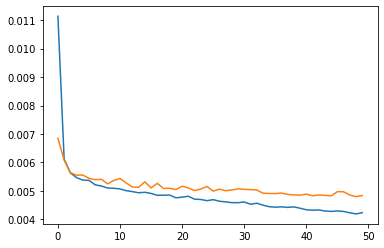

In [96]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.show()

Como antes, vamos visualizar a predição no conjunto de testes:

In [97]:
y_pred_m = model.predict(x_test)

In [98]:
zipped_lists = zip(y_test, y_pred_m)
sorted_pairs = sorted(zipped_lists)

tuples = zip(*sorted_pairs)
y_test_m, y_predict_m = [ list(tuple) for tuple in  tuples]

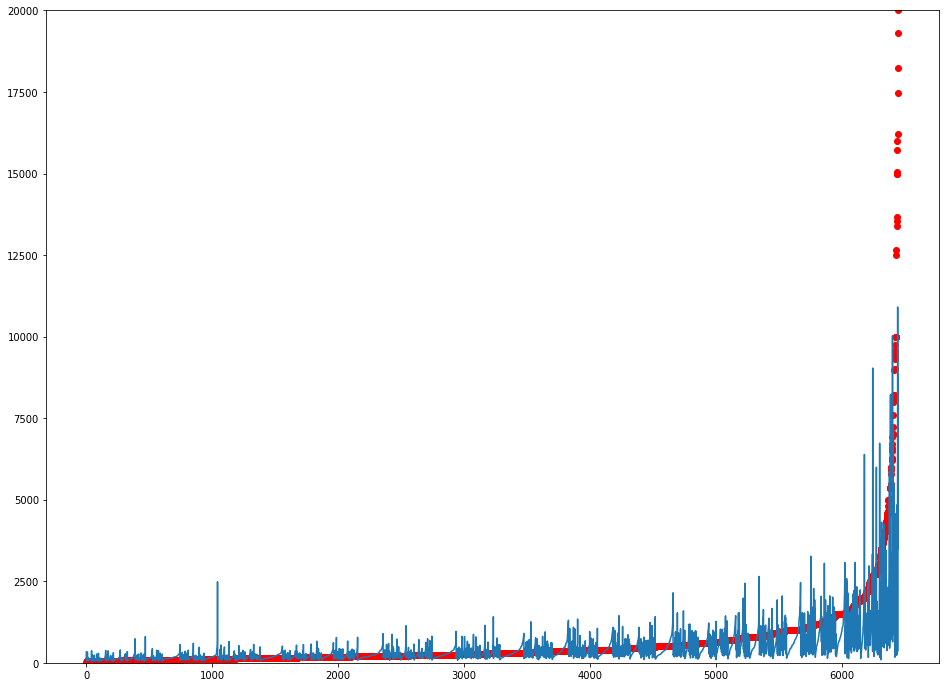

In [99]:
import math
fig=plt.figure(figsize=(16,12))
plt.ylim((0, 20000))
y_test_rev = scaler_y_train.inverse_transform(y_test_m)
y_predict_s_rev = scaler_y_train.inverse_transform(y_predict_m)
y_test_real = [10**x for x in y_test_rev]
y_predict_real = [10**x for x in y_predict_s_rev]
y_test_rev
plt.plot(y_test_real,'ro')
plt.plot(y_predict_real)
        
plt.show()

In [100]:
mae = mean_absolute_error(y_test_real,y_predict_real)
mae

299.28653570294387

Como podemos ver, a performance da MLP foi muito próxima à performance da regressão linear.

# Conclusão

Dentre os métodos, a __Regressão Linear__ obteve a melhor performance, apesar de os resultados terem sido semelhantes.
Vemos também que, apesar da predição acompanhar a tendência do valor real, existe uma flutuação considerável do valor previsto. 

Tendo obtidos resultados parecidos entre os 3 métodos, podemos inferir que existe uma influência na variável alvo não explicada pelas variáveis de entrada.

Como expansão desta análise, poderíamos voltar à etapa de exploração para tentarmos extrair mais informação dos dados extraídos, e procurar mais fontes de dados para possivelmente enriquecer nossas variáveis de entrada.



# Referências

1 - HALL, Mark Andrew. Correlation-based feature selection for machine learning.
University of Waikato Hamilton, New Zealand, 1999.

2 - https://jakevdp.github.io/PythonDataScienceHandbook/05.06-linear-regression.html